```bash
uv venv
source .venv/bin/activate

uv pip install jupyterlab matplotlib scanpy==1.10.2 squidpy==1.6.0 watermark
uv pip install ruff mypy # optional
uv pip install tensorflow tensorflow-metal
uv pip install stardist
uv pip install bin2cell==0.3.0

uv pip freeze > env.txt
```

Apple's documentation for installing TensorFlow: https://developer.apple.com/metal/tensorflow-plugin/


GitHub repo: https://github.com/Teichlab/bin2cell

PyPI: https://pypi.org/project/bin2cell/

preprint: https://www.biorxiv.org/content/10.1101/2024.06.19.599766v1

StarDist repo: https://github.com/stardist/stardist?tab=readme-ov-file

Read the Docs: https://bin2cell.readthedocs.io/en/latest/

In [1]:
%matplotlib inline
%config InlineBackend.figure_format='retina'

Demo notebook: https://nbviewer.org/github/Teichlab/bin2cell/blob/main/notebooks/demo.ipynb

Changes compared to the demo notebook:

- using 'squidpy' alongside 'scanpy'
- using `pathlib` instead of `os`

In [2]:
from pathlib import Path
from typing import Final

import bin2cell as b2c
import matplotlib.pyplot as plt
import pandas as pd
import scanpy as sc
import squidpy as sq

Getting data:

10x Genomics data, "Visium HD Spatial Gene Expression Library, Mouse Brain (FFPE)": https://www.10xgenomics.com/datasets/visium-hd-cytassist-gene-expression-libraries-of-mouse-brain-he

![Dataset site.](./assets/Screenshot%202024-08-31%20at%202.56.00 PM.webp)

![Spatial and expression data files.](./assets/Screenshot%202024-08-31%20at%202.49.05 PM.webp)

![Microscopy image file.](./assets/Screenshot%202024-08-31%20at%202.49.17 PM.webp)

```bash
mkdir data && cd data

# Binned expression data.
curl -O https://cf.10xgenomics.com/samples/spatial-exp/3.0.0/Visium_HD_Mouse_Brain/Visium_HD_Mouse_Brain_binned_outputs.tar.gz
tar -xzkf Visium_HD_Mouse_Brain_binned_outputs.tar.gz

# Spatial data
curl -O https://cf.10xgenomics.com/samples/spatial-exp/3.0.0/Visium_HD_Mouse_Brain/Visium_HD_Mouse_Brain_spatial.tar.gz
tar -xzkf Visium_HD_Mouse_Brain_spatial.tar.gz

curl -O https://cf.10xgenomics.com/samples/spatial-exp/3.0.0/Visium_HD_Mouse_Brain/Visium_HD_Mouse_Brain_tissue_image.tif

ls -lh .
cd -
#> total 9504904
#> -rw-r--r--  1 jhrcook  staff   4.3G Aug 31 14:52 Visium_HD_Mouse_Brain_binned_outputs.tar.gz
#> -rw-r--r--  1 jhrcook  staff    68M Aug 31 14:52 Visium_HD_Mouse_Brain_spatial.tar.gz
#> -rw-r--r--  1 jhrcook  staff   138M Aug 31 14:52 Visium_HD_Mouse_Brain_tissue_image.tif
#> drwxr-xr-x  5 jhrcook  staff   160B Apr 10 17:24 binned_outputs
#> drwxr-xr-x  8 jhrcook  staff   256B Apr  1 14:01 spatial
```

In [3]:
DATA_DIR: Final[Path] = Path("./data")
square_2um_dir = DATA_DIR / "binned_outputs" / "square_002um"
source_image_file = DATA_DIR / "Visium_HD_Mouse_Brain_tissue_image.tif"
spaceranger_dir = DATA_DIR / "spatial"

In [4]:
OUTPUT_DIR: Final[Path] = Path("./output")
OUTPUT_DIR.mkdir(exist_ok=True)

In [5]:
spatial_adata = b2c.read_visium(
    square_2um_dir,
    source_image_path=source_image_file,
    spaceranger_image_path=spaceranger_dir,
)
spatial_adata.var_names_make_unique()
spatial_adata.obs_names_make_unique()
spatial_adata

anndata.py (1756): Variable names are not unique. To make them unique, call `.var_names_make_unique`.


anndata.py (1756): Variable names are not unique. To make them unique, call `.var_names_make_unique`.


AnnData object with n_obs × n_vars = 6296688 × 19059
    obs: 'in_tissue', 'array_row', 'array_col'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [6]:
sc.pp.filter_genes(spatial_adata, min_cells=3)
sc.pp.filter_cells(spatial_adata, min_counts=1)
spatial_adata

AnnData object with n_obs × n_vars = 6132629 × 18823
    obs: 'in_tissue', 'array_row', 'array_col', 'n_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial'
    obsm: 'spatial'

Finding interesting region.

Including this because it can be a very slow and frustrating process with 'squidpy'.

Trial and error process.

Recommend finding the region without plotting expression overlay and using "lowres" image.

In [7]:
print(f"Min: {spatial_adata.obsm['spatial'].min(axis=0)}")
print(f"Max: {spatial_adata.obsm['spatial'].max(axis=0)}")

Min: [318.86734779 329.31090661]
Max: [18661.98062857 23523.33133961]


In [8]:
x0, y0, d = 12_500, 6_000, 2_000
crop_coords = x0, y0, x0 + d, y0 + d
crop_coords

(12500, 6000, 14500, 8000)

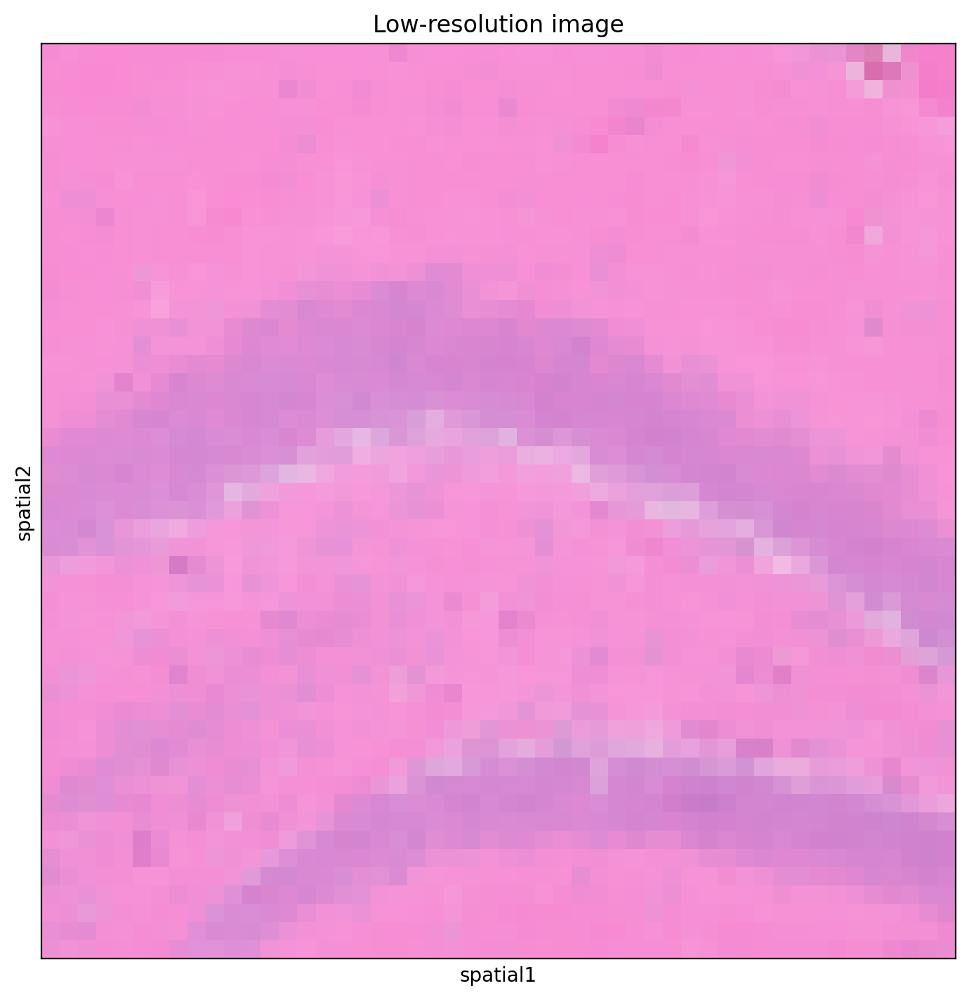

In [9]:
sq.pl.spatial_scatter(
    spatial_adata,
    spatial_key="spatial",
    img_res_key="lowres",
    crop_coord=crop_coords,
    figsize=(7, 7),
    title="Low-resolution image",
)
plt.show()

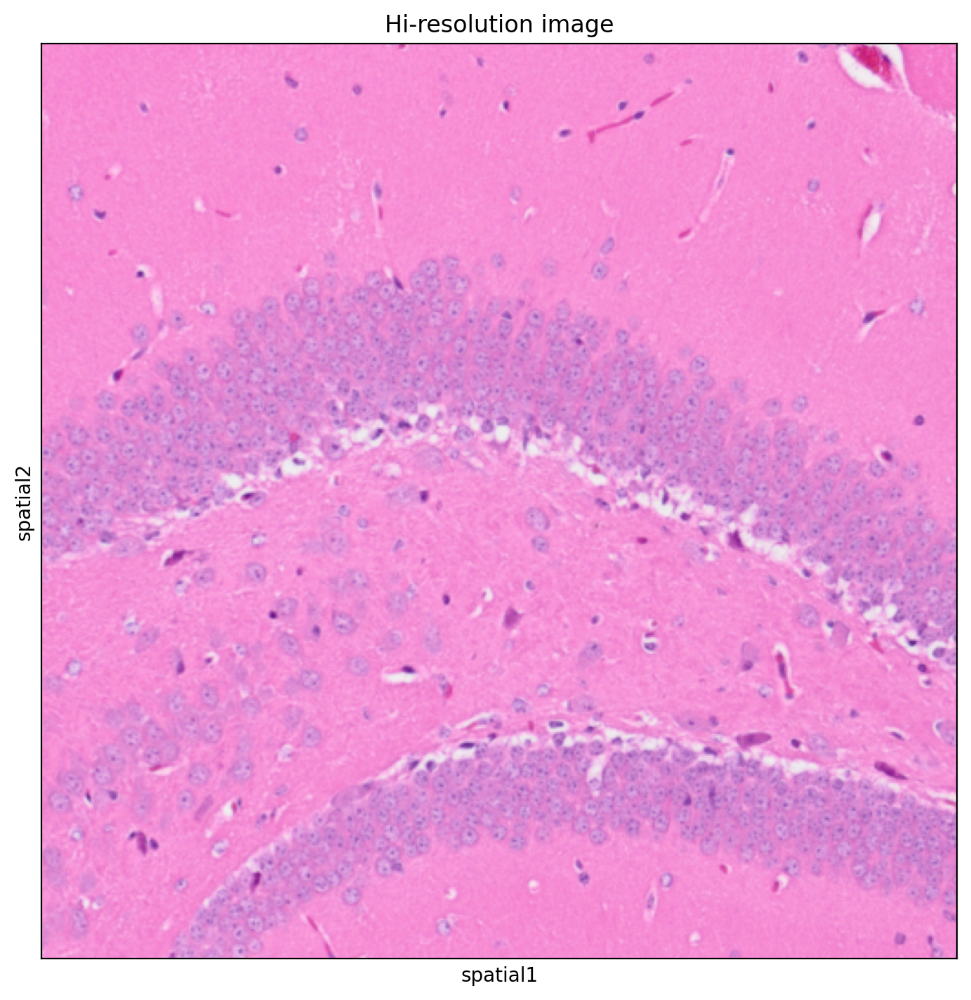

In [10]:
sq.pl.spatial_scatter(
    spatial_adata,
    spatial_key="spatial",
    img_res_key="hires",
    crop_coord=crop_coords,
    figsize=(7, 7),
    title="Hi-resolution image",
)
plt.show()

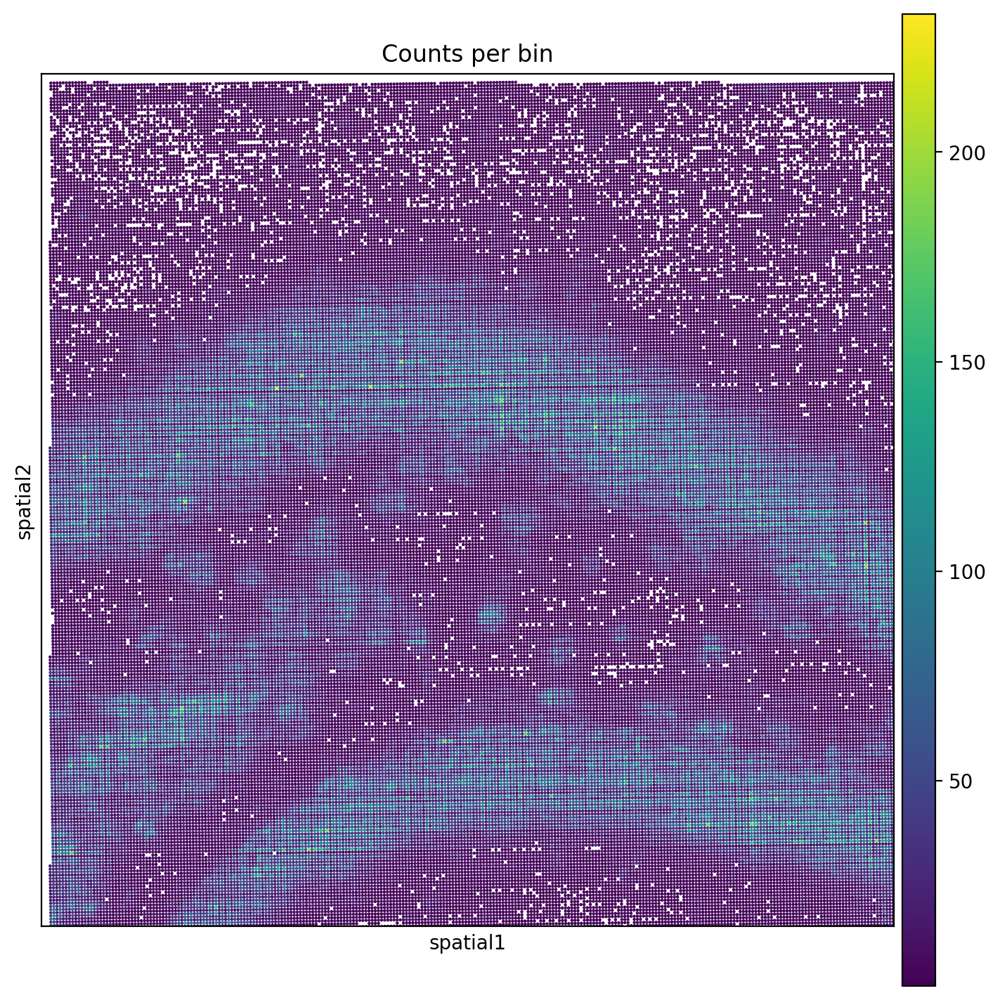

In [11]:
sq.pl.spatial_scatter(
    spatial_adata,
    spatial_key="spatial",
    img_res_key="lowres",
    img_alpha=0,
    color="n_counts",
    cmap="viridis",
    crop_coord=crop_coords,
    figsize=(7, 7),
    title="Counts per bin",
)
plt.show()

In [12]:
b2c.destripe(spatial_adata)

_construct.py (149): Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`


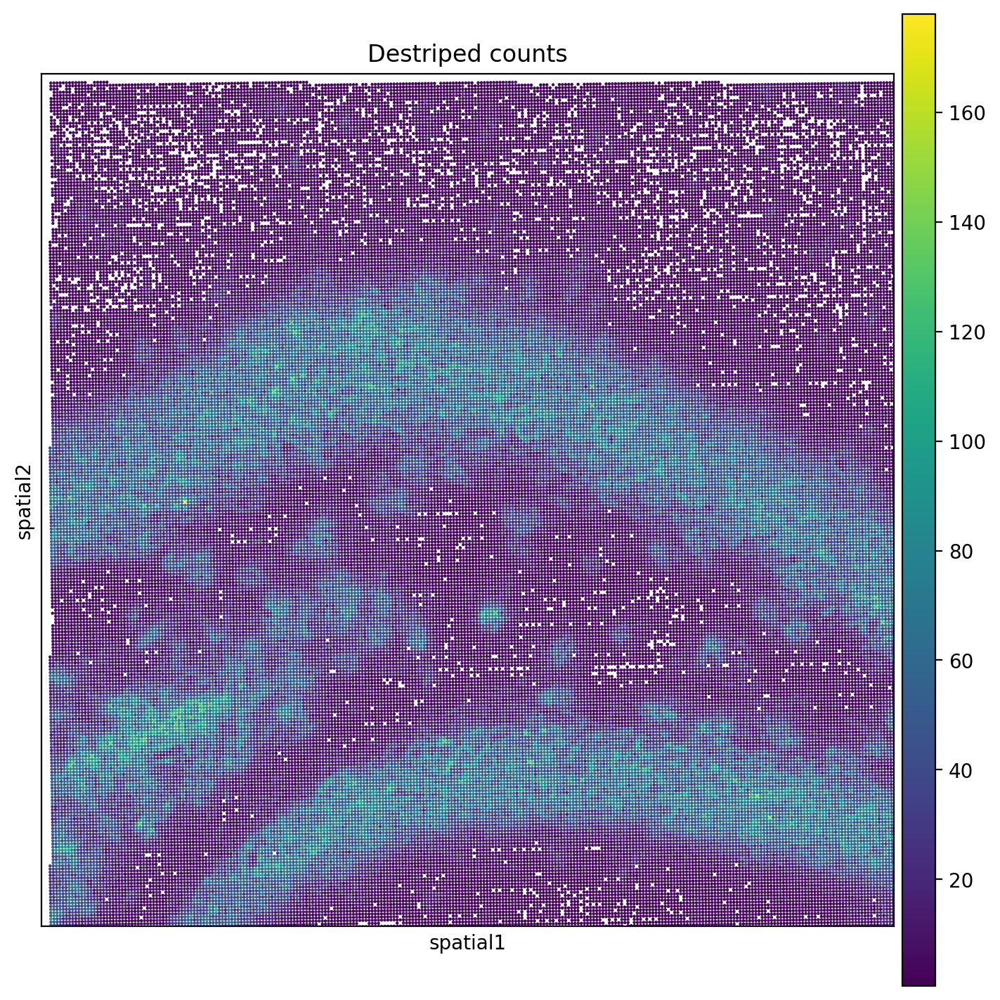

In [13]:
sq.pl.spatial_scatter(
    spatial_adata,
    spatial_key="spatial",
    img_res_key="lowres",
    img_alpha=0,
    color="n_counts_adjusted",
    cmap="viridis",
    crop_coord=crop_coords,
    figsize=(7, 7),
    title="Destriped counts",
)
plt.show()

In [14]:
B2C_MPP: Final[float] = 0.5
stardist_he_file = OUTPUT_DIR / "he.tiff"

b2c.scaled_he_image(spatial_adata, mpp=B2C_MPP, save_path=stardist_he_file)
spatial_adata

AnnData object with n_obs × n_vars = 6132629 × 18823
    obs: 'in_tissue', 'array_row', 'array_col', 'n_counts', 'destripe_factor', 'n_counts_adjusted'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial'
    obsm: 'spatial', 'spatial_cropped'

In [15]:
list(OUTPUT_DIR.iterdir())

[PosixPath('output/he.tiff')]

In [16]:
stardist_output_file = OUTPUT_DIR / "he.npz"
b2c.stardist(
    image_path=stardist_he_file,
    labels_npz_path=stardist_output_file,
    stardist_model="2D_versatile_he",
    prob_thresh=0.01,
)

Found model '2D_versatile_he' for 'StarDist2D'.


2024-09-01 08:28:45.787684: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M2 Pro
2024-09-01 08:28:45.787705: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 32.00 GB
2024-09-01 08:28:45.787712: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 10.67 GB
2024-09-01 08:28:45.787725: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2024-09-01 08:28:45.787736: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.
effective: block_size=(4096, 4096, 3), min_overlap=(128, 128, 0), context=(128, 128, 0)


2024-09-01 08:28:46.193673: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:117] Plugin optimizer for device_type GPU is enabled.


  0%|                                                                                                                                                      | 0/12 [00:00<?, ?it/s]

  8%|███████████▊                                                                                                                                  | 1/12 [00:04<00:45,  4.17s/it]

 17%|███████████████████████▋                                                                                                                      | 2/12 [00:10<00:54,  5.42s/it]

 25%|███████████████████████████████████▌                                                                                                          | 3/12 [00:23<01:19,  8.81s/it]

 33%|███████████████████████████████████████████████▎                                                                                              | 4/12 [00:28<00:57,  7.23s/it]

 42%|███████████████████████████████████████████████████████████▏                                                                                  | 5/12 [00:32<00:43,  6.25s/it]

 50%|███████████████████████████████████████████████████████████████████████                                                                       | 6/12 [00:38<00:37,  6.18s/it]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 7/12 [00:43<00:28,  5.79s/it]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 8/12 [00:47<00:21,  5.32s/it]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 9/12 [00:52<00:14,  5.00s/it]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 10/12 [00:56<00:09,  4.66s/it]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 11/12 [01:00<00:04,  4.53s/it]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [01:03<00:00,  4.22s/it]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [01:03<00:00,  5.33s/it]

Found 61984 objects


In [17]:
b2c.insert_labels(
    spatial_adata,
    labels_npz_path=str(stardist_output_file),
    basis="spatial",
    spatial_key="spatial_cropped",
    mpp=B2C_MPP,
    labels_key="labels_he",
)
spatial_adata

AnnData object with n_obs × n_vars = 6132629 × 18823
    obs: 'in_tissue', 'array_row', 'array_col', 'n_counts', 'destripe_factor', 'n_counts_adjusted', 'labels_he'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial', 'bin2cell'
    obsm: 'spatial', 'spatial_cropped'

In [18]:
b2c.expand_labels(
    spatial_adata,
    labels_key="labels_he",
    expanded_labels_key="labels_he_expanded",
    max_bin_distance=2,
)

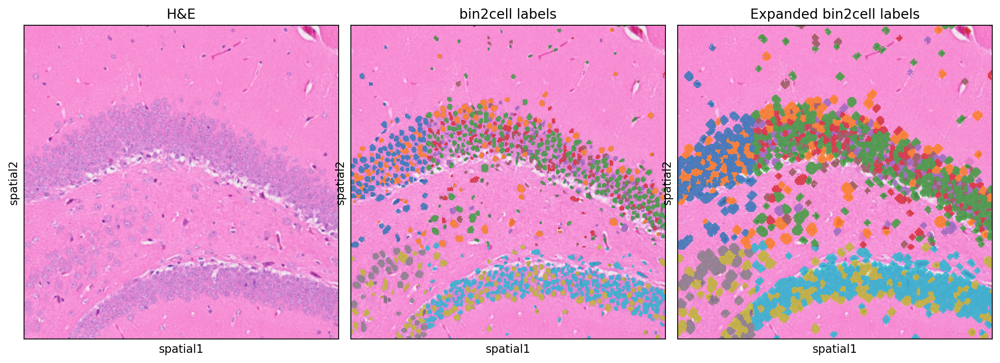

In [19]:
# Stardist label of "0" means unassigned to a cell.
for col in ("labels_he", "labels_he_expanded"):
    spatial_adata.obs[f"{col}_viz"] = spatial_adata.obs[col].copy()
    spatial_adata.obs.loc[spatial_adata.obs[col] == 0, f"{col}_viz"] = pd.NA

sq.pl.spatial_scatter(
    spatial_adata,
    spatial_key="spatial",
    img_res_key="hires",
    color=[None, "labels_he_viz", "labels_he_expanded_viz"],
    crop_coord=crop_coords,
    cmap="tab10",
    figsize=(5, 5),
    colorbar=False,
    wspace=0.005,
    ncols=3,
    title=["H&E", "bin2cell labels", "Expanded bin2cell labels"],
)
plt.show()

In [20]:
b2c_adata = b2c.bin_to_cell(
    spatial_adata, labels_key="labels_he", spatial_keys=["spatial"]
)
b2c_adata

AnnData object with n_obs × n_vars = 61842 × 18823
    obs: 'bin_count', 'array_row', 'array_col'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial'
    obsm: 'spatial'

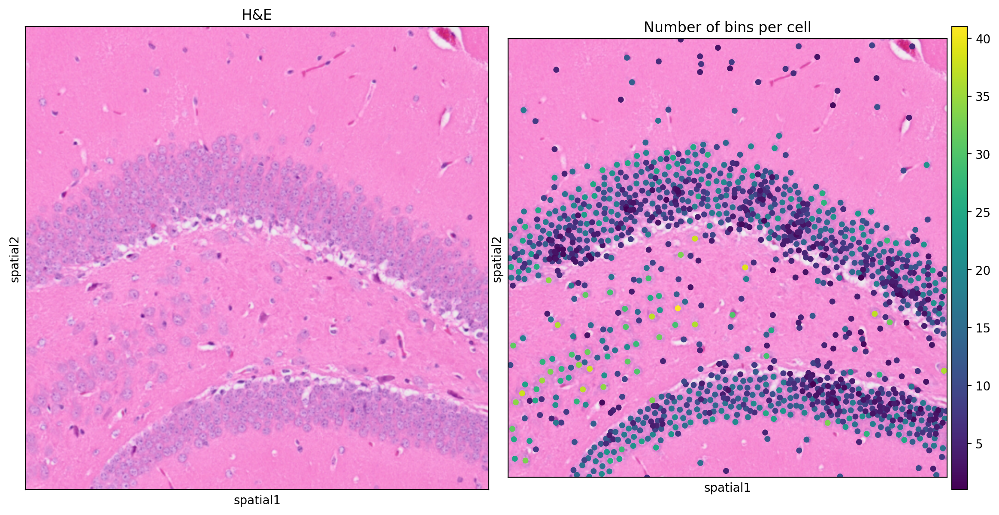

In [21]:
sq.pl.spatial_scatter(
    b2c_adata,
    spatial_key="spatial",
    img_res_key="hires",
    color=[None, "bin_count"],
    cmap="viridis",
    crop_coord=crop_coords,
    title=["H&E", "Number of bins per cell"],
    figsize=(7, 7),
    wspace=0.02,
)

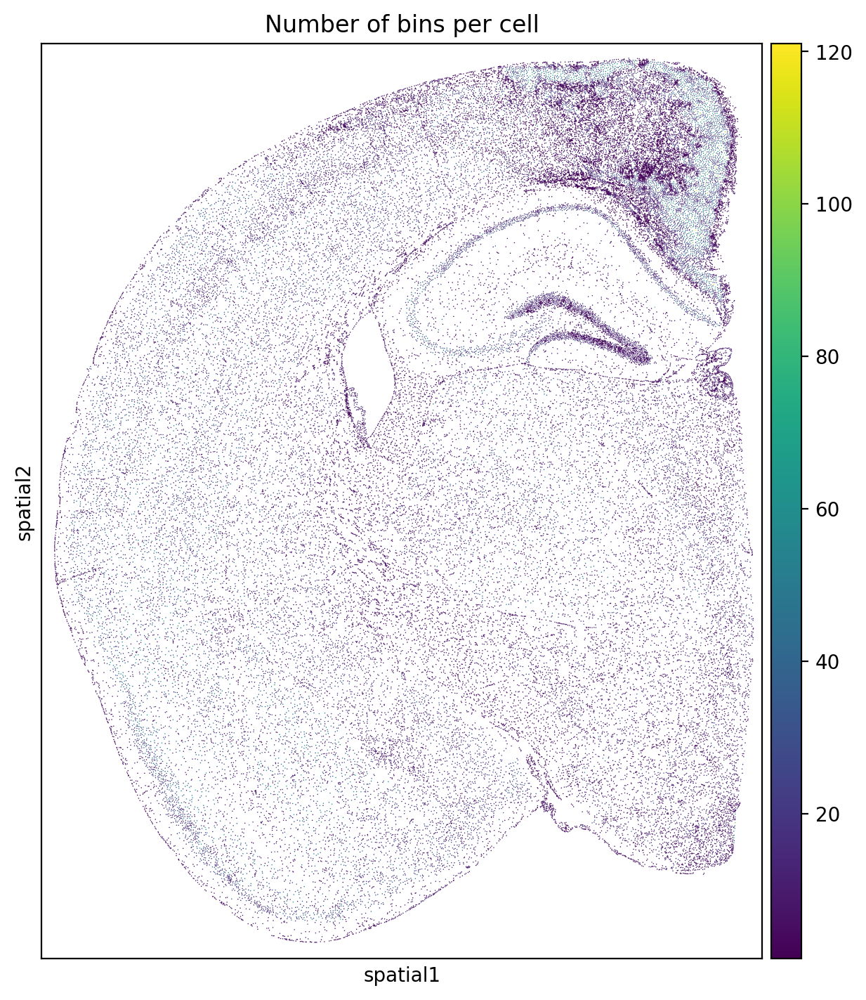

In [22]:
sq.pl.spatial_scatter(
    b2c_adata,
    spatial_key="spatial",
    img_res_key="lowres",
    img_alpha=0,
    color="bin_count",
    cmap="viridis",
    # crop_coord=crop_coords,
    figsize=(7, 7),
    wspace=0.02,
    title="Number of bins per cell",
)

In [23]:
b2c_adata.write_h5ad(OUTPUT_DIR / "b2c-output.h5ad")

---

## Session information

In [24]:
%load_ext watermark
%watermark -d -u -v -iv -b -h -m

Last updated: 2024-09-01

Python implementation: CPython
Python version       : 3.11.8
IPython version      : 8.27.0

Compiler    : Clang 15.0.0 (clang-1500.1.0.2.5)
OS          : Darwin
Release     : 23.5.0
Machine     : arm64
Processor   : arm
CPU cores   : 12
Architecture: 64bit

Hostname: Joshuas-MacBook-Pro.local

Git branch: main

squidpy   : 1.6.0
matplotlib: 3.9.2
bin2cell  : 0.3.0
pandas    : 2.2.2
scanpy    : 1.10.2

